In [1]:
%cd /home/yuchen/venv/Faster_RCNN

/home/yuchen/venv/Faster_RCNN


In [2]:
import torch
import torchvision
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms, datasets, models
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import random
import glob
from torch.utils.data import Dataset, DataLoader

import yaml
import xml.etree.ElementTree as ET

from datasets import custom_dataset
import cv2

def collate_fn(batch):
    return tuple(zip(*batch))

def annotate(outputs, threshold, classes, colors, image):
    boxes = outputs[0]['boxes'].data.numpy()
    scores = outputs[0]['scores'].data.numpy()
    boxes = boxes[scores >= threshold].astype(np.int32)
    
    for box, score, label in zip(boxes, scores, outputs[0]['labels']):
#         text = str(classes[label]) + ' ' + str(round(score,2))
        text = str(round(score,2))
        color = colors[label]
        font_size  = image.shape[0]//100 - 1
        cv2.rectangle(image, (box[0], box[1]), (box[2], box[3]), color, thickness=5)
        cv2.putText(image, text, (box[0], box[1] - 5),  cv2.FONT_HERSHEY_SIMPLEX, 1 , (255,255,255), 
                    thickness=2)
    return image

In [3]:
np.random.seed(42)

with open('/home/yuchen/venv/Faster_RCNN/handicap.yaml') as file:
    configs = yaml.safe_load(file)
NUM_CLASSES = configs['NC']
CLASSES = configs['CLASSES']

# DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
DEVICE = torch.device('cpu')  
project_name = 'final_seed_v1'
PATH = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_images/'
THRESHOLD = 0.5
IMG_SIZE = 1280
VALID_DIR_IMAGES = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_images'
VALID_DIR_LABELS = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_labels'
BATCH_SIZE = 10
NUM_CLASSES = 2
NUM_WORKERS = 4
COLORS = np.random.uniform(0, 255, size=(len(CLASSES), 3))

In [4]:
# load images
test_images = []
image_file_types = ['*.jpg','*.jpeg','*.png','*.JPG']
for file_type in image_file_types:
    test_images.extend(glob.glob(PATH + '*' + file_type))

# load model and weights
model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(
        weights=torchvision.models.detection.FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT,
        trainable_backbone_layers = 2)    
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, NUM_CLASSES) 

checkpoint = torch.load('/home/yuchen/venv/Faster_RCNN/outputs/training/' + project_name + '/best_model.pth', map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

model.to(DEVICE).eval()

# load data
test_dataset = custom_dataset(VALID_DIR_IMAGES, VALID_DIR_LABELS, IMG_SIZE, IMG_SIZE, CLASSES, train=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, 
                              shuffle=False, num_workers=NUM_WORKERS,collate_fn=collate_fn)

Total number of images: 21


/tmp/ipykernel_1738547/3299176716.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(14,14))


'\nnote: here I only showed the confidence score for each image, \nbecause if I add the predicted class (which is "handicap" because we are only detecting this class),\nsome numbers will be outside of the image boundary. \n'

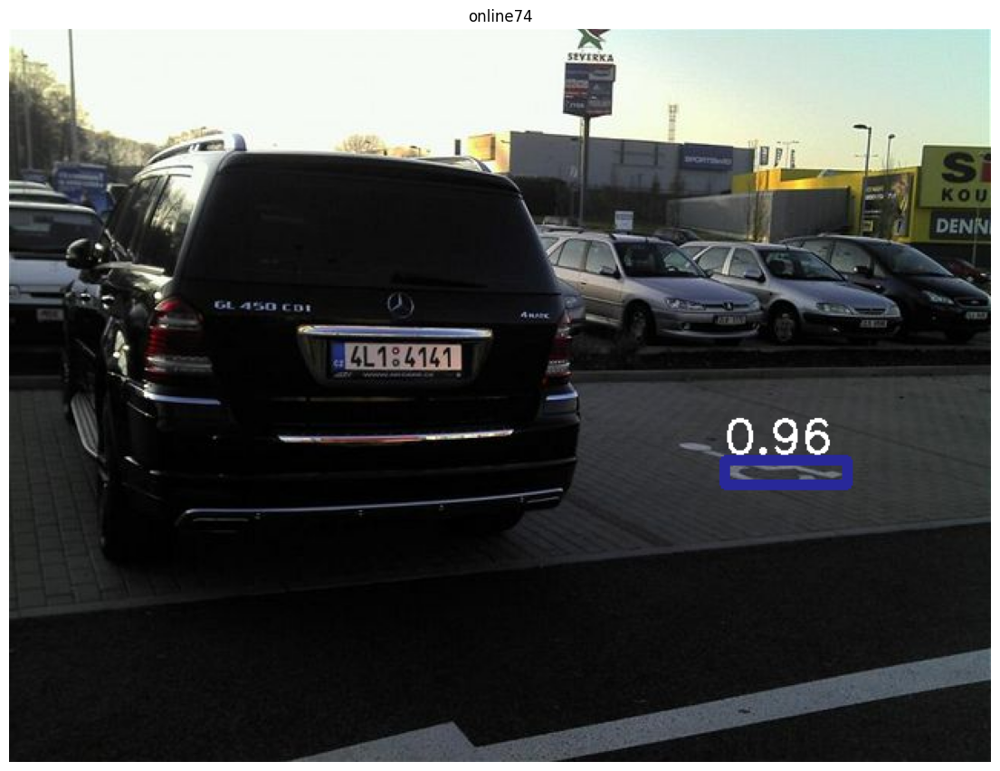

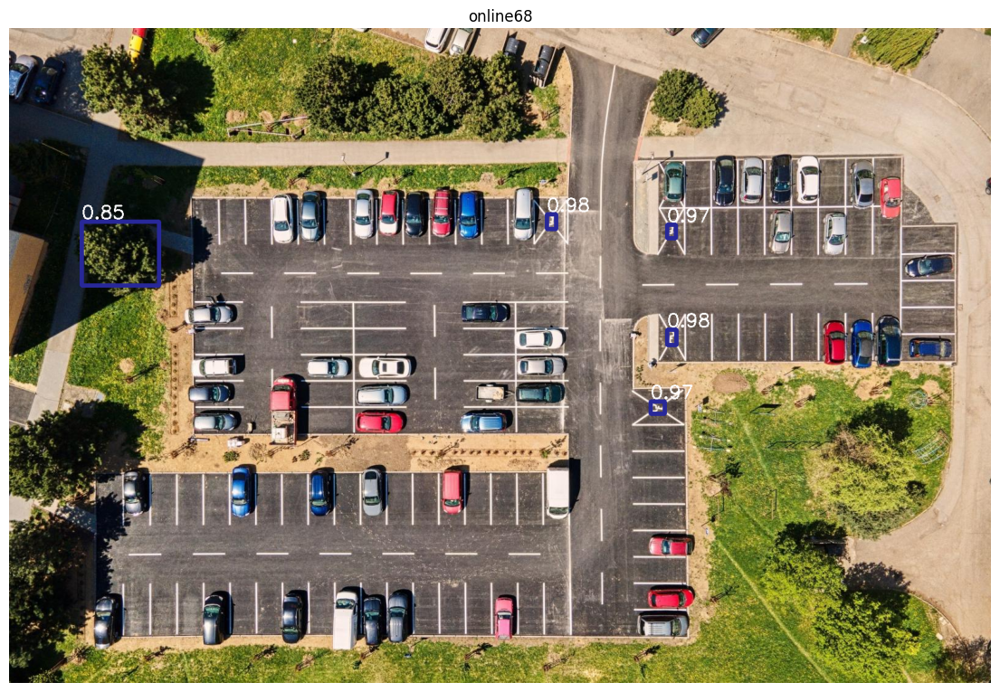

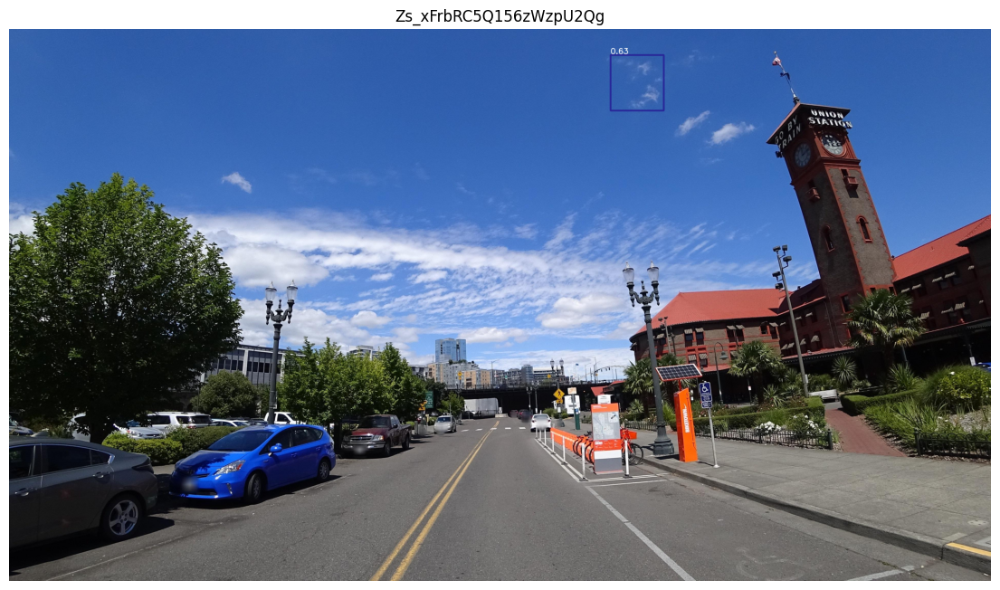

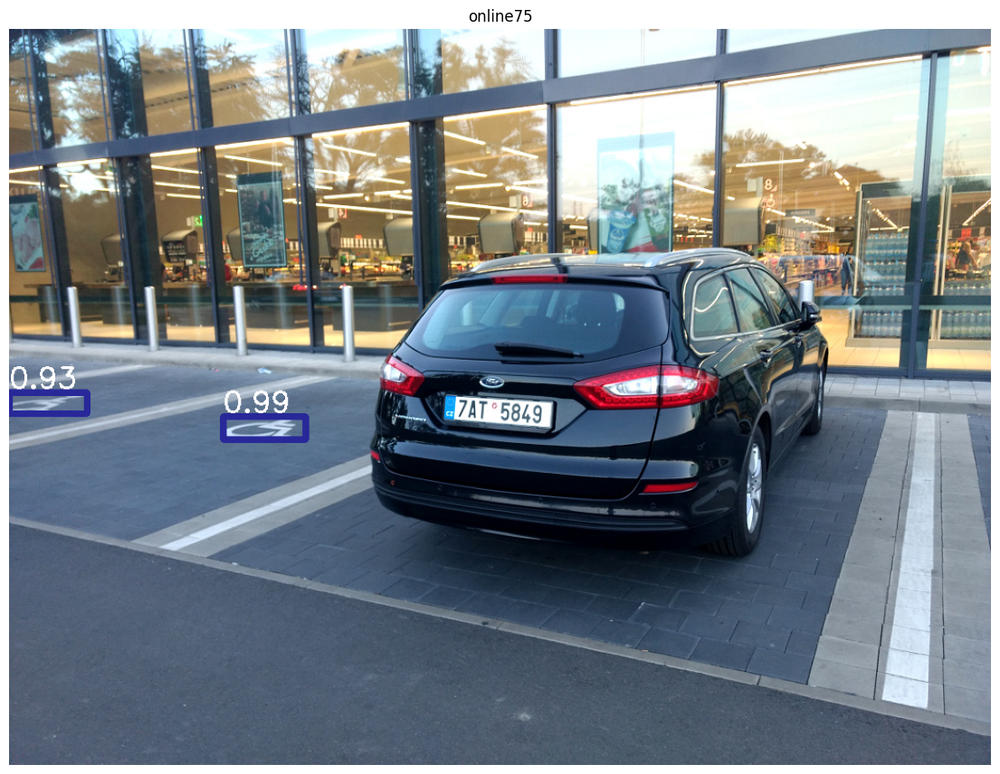

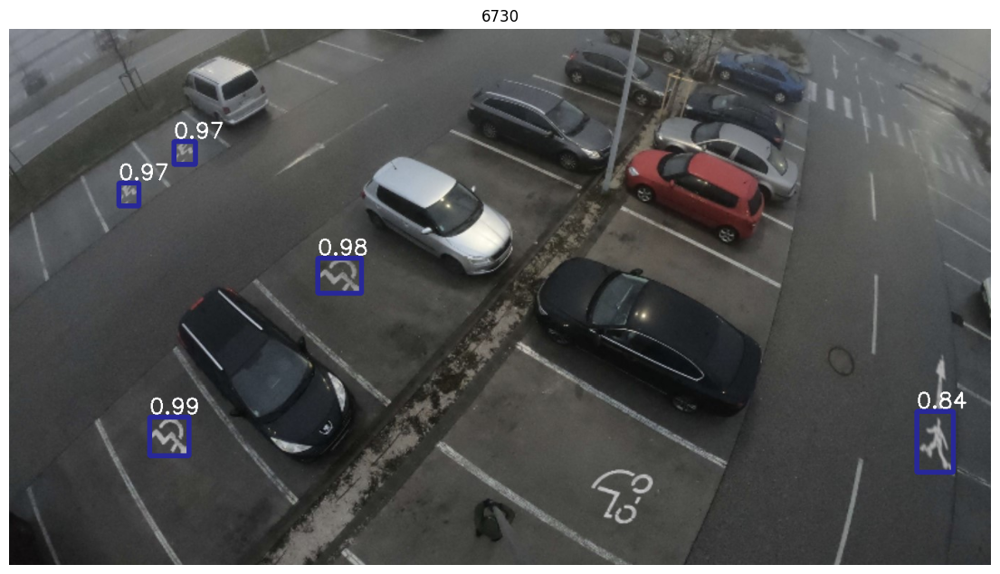

...

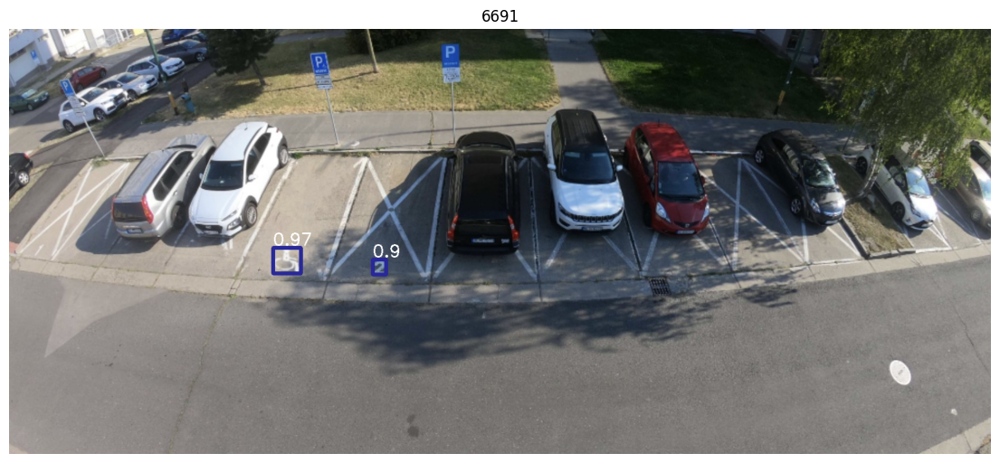

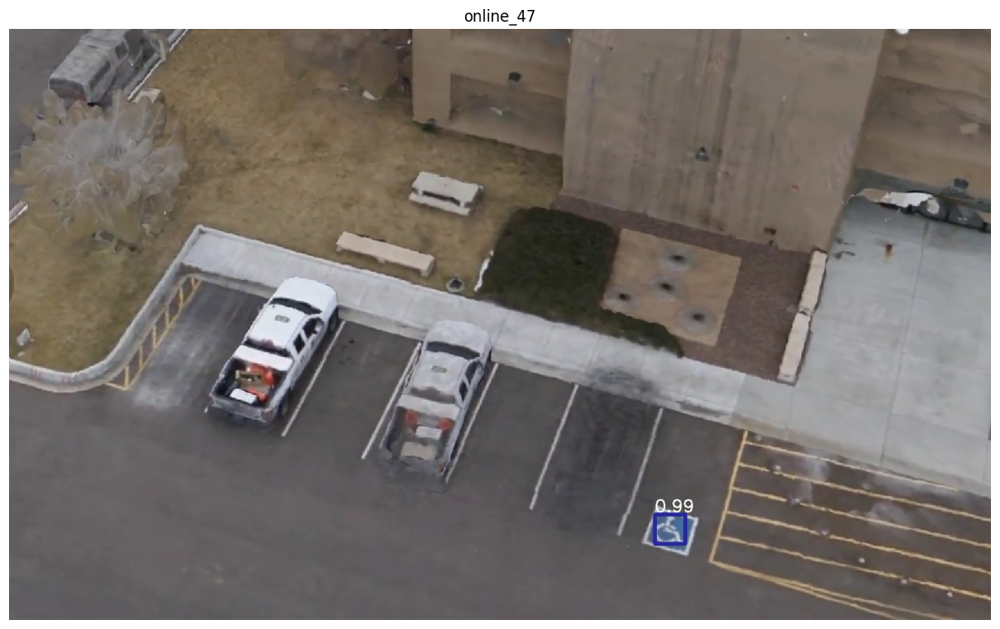

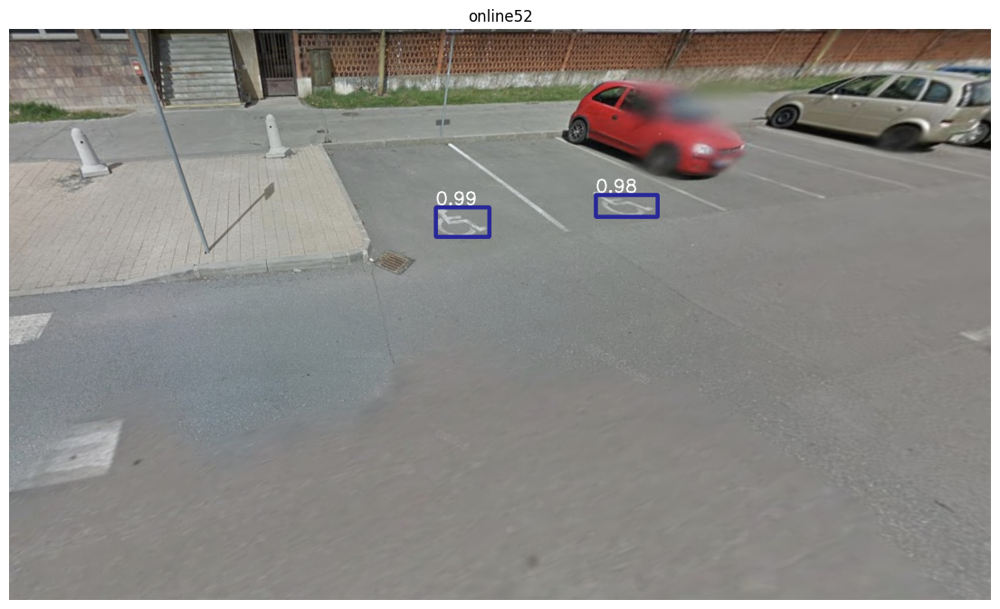

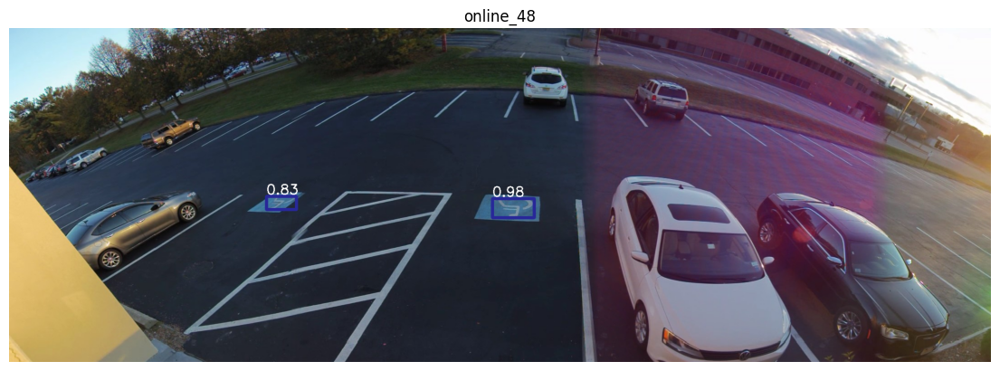

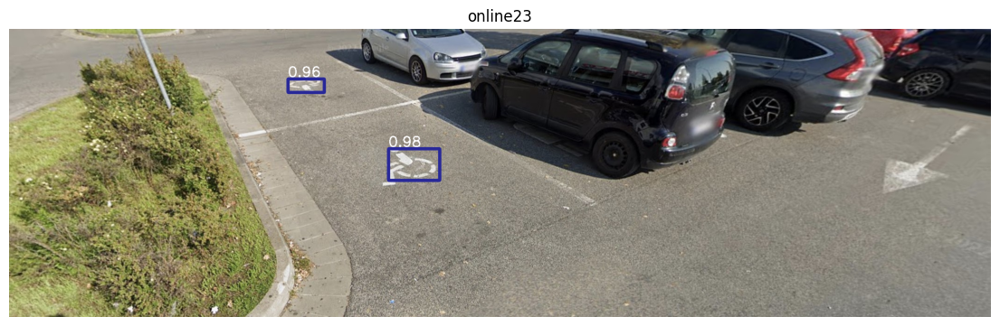

In [5]:
# Annotation
# load images
VALID_DIR_IMAGES = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_images'  # feature engineered images
VALID_DIR_IMAGES_ORIGINAL = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_images_original' # original engineered images
VALID_DIR_LABELS = '/home/yuchen/venv/Faster_RCNN/data_sign/valid_labels'

test_images = []
image_file_types = ['*.jpg', '*.jpeg', '*.png','*.JPG']
for file_type in image_file_types:
    test_images.extend(glob.glob(PATH + '*' + file_type))
print('Total number of images: ' + str(len(test_images)))

name = []
bndbox = []

# predict bounding boxes using the feature engineered images and annotate them on the original images
for i in range(len(test_images)):
    name.append(test_images[i].split(os.path.sep)[-1].split('.')[0] + ".jpg")
    image_name = test_images[i].split(os.path.sep)[-1].split('.')[0]
    image_original = cv2.imread(VALID_DIR_IMAGES_ORIGINAL + '/' + image_name + '.jpg')
    image = cv2.imread(test_images[i])
    image_o = image.copy()
        
    trans = transforms.Compose([transforms.ToPILImage(),transforms.ToTensor()])
    image = torch.unsqueeze(trans(cv2.cvtColor(image_o, cv2.COLOR_BGR2RGB)), 0)
    with torch.no_grad():
        outputs = model(image.to(DEVICE))
    outputs = [{k: v.to('cpu') for k, v in t.items()} for t in outputs]
    bndbox.append(outputs)
    
    if len(outputs[0]['boxes']) != 0:
        image_original = annotate(outputs, THRESHOLD, CLASSES, COLORS, image_original)
        plt.figure(figsize=(14,14))
        plt.axis('off')
        plt.title(image_name)
        plt.imshow(cv2.cvtColor(image_original, cv2.COLOR_BGR2RGB))
        
'''
note: here I only showed the confidence score for each image, 
because if I add the predicted class (which is "handicap" because we are only detecting this class),
some numbers will be outside of the image boundary. 
'''        